# LSI-1 analysis
Cells selected based on ArchR's CreateArrowFiles() function with n_frags > 1000 and TSSe > 7

In [3]:
import os
import csv
import scipy
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import episcanpy.api as epi
from sklearn.feature_extraction.text import TfidfTransformer
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import style
import warnings
import pickle
import harmonypy
style.use("default")
warnings.filterwarnings('ignore')
%config InlineBackend.figure_format = "retina"
from lsi_functions import *
os.chdir("/data/proj/GCB_MK/CZI/episcanpy_analysis/AGG_ATAC_210218")
plt.rcParams["figure.figsize"] = (9.6,7.2)

In [51]:
## Flatten a list of lists
def flatten(t):
    return [i for s in t for i in s]
    
## plot correlation between principal components and sequencing depth
def plotDepthCorr(adata, n_comps = 10):
    PC_depth_corr = []
    for PC in range(adata.obsm["X_pca"].shape[1]):
        corr = scipy.stats.pearsonr(adata.obs["nb_features"], adata.obsm["X_pca"][:,PC])[0]
        PC_depth_corr.append(corr)
    plt.plot([x for x in range(1,n_comps+1)], PC_depth_corr[:n_comps], 'o', color='black');
    plt.xlabel("PC");
    plt.ylabel("Correlation Coefficient");
    plt.title("Correlation between Components and Sequencing depth");

## Run TF-IDF normalization
def runTfIdf(adata, run_norm=False):
    X = adata.layers["raw_counts"]
    if run_norm:
        tfidf = TfidfTransformer(use_idf=True)
    else:
        tfidf = TfidfTransformer(use_idf=True, norm=False)
    X_norm = tfidf.fit_transform(X)
    adata.X = X_norm


## Run SVD, build kNN graph and do leiden clustering
def runLsi(adata, cluster_key_added = "leiden"):
    sc.tl.pca(adata, zero_center=False, n_comps=31)
    sc.pp.neighbors(adata, n_pcs=30, metric="cosine")
    sc.tl.umap(adata)
    cluster_res = [0.5, 0.7, 0.9]
    for res in cluster_res:
        sc.tl.leiden(adata, resolution = res, key_added = f"{cluster_key_added}_{res}")

## Select top variable features across each cluster 
def selectVarFeatures(adata, use_key="leiden_0.5"):
    var_features = []
    for cluster in set(adata.obs[use_key]):
        minidata = adata[adata.obs[use_key]==cluster].copy()
        if minidata.shape[0] < 500:
            continue
        else:
            minidata.var["n_cells"] = np.sum(minidata.layers["raw_counts"], axis=0).T
            minidata.var["z_score_acc"] = scipy.stats.zscore(minidata.var["n_cells"])
            minidata.var["abs_z"] = [abs(x) for x in minidata.var["z_score_acc"]]
            var_features.append(minidata[:,minidata.var["abs_z"]>1.65].var_names.tolist())

    var_features = list(set(flatten(var_features)))
    return adata[:,var_features].copy()


## Do initial filtering 

In [4]:
adata = ad.read("PIPELINE/data/matrices/211206_2kb_archr_matrix_LOADED.h5ad")
## Remove cells with <3,000 and >20,000 features
epi.pp.filter_cells(adata, min_features=3000)
epi.pp.filter_cells(adata, max_features=20000)
## Select only top 100,000 accessible features
epi.pp.filter_features(adata, min_cells=1)

## Remove bad QC samples identified by Jilin and the SD036/16 samples
bad_samples = ["P20057_1002","P20602_1005","P20603_1007","P20908_1008","P22551_1002","P22551_1004","P22551_1005","P22551_1006","P22551_1008","P20908_1017","P20602_1002"]
adata = adata[~adata.obs["NGI_ID"].isin(bad_samples)].copy()
min_cells = np.sort(adata.var["n_cells"])[-100000]
adata = adata[:, adata.var["n_cells"] >= min_cells].copy()
adata.obs["log_nb_features"] = [np.log10(x) for x in adata.obs["nb_features"]]

## Plot features

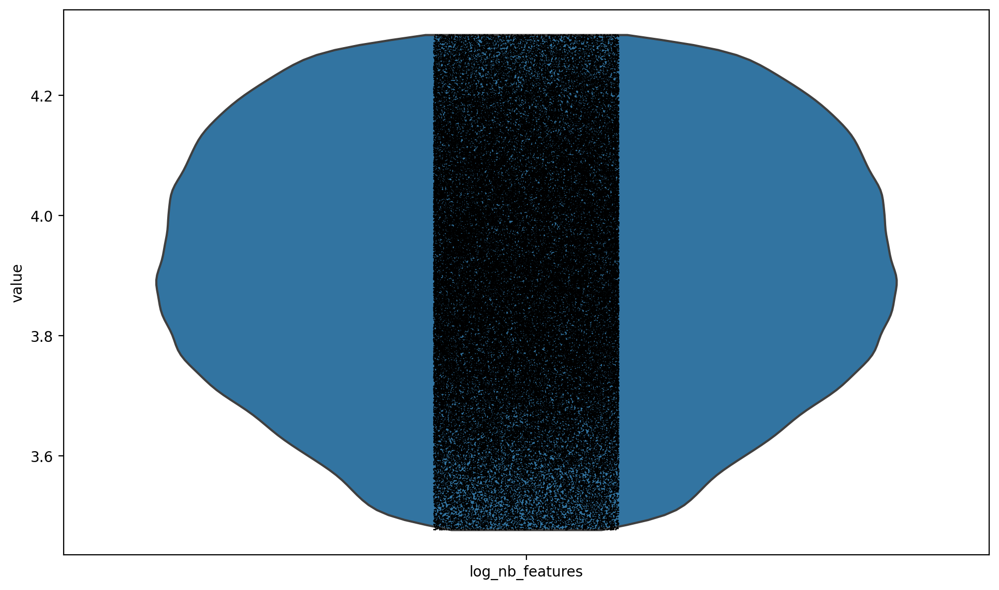

In [7]:
epi.pl.violin(adata, "log_nb_features")

In [ ]:
cluster_res = [0.5, 0.7, 0.9]

## Iterative Clustering Round 1

In [10]:
adata.layers["raw_counts"] = adata.X.copy()
runTfIdf(adata) ## Calculated on Raw counts and NOT on binarized matrix
runLsi(adata, cluster_key_added="leiden")

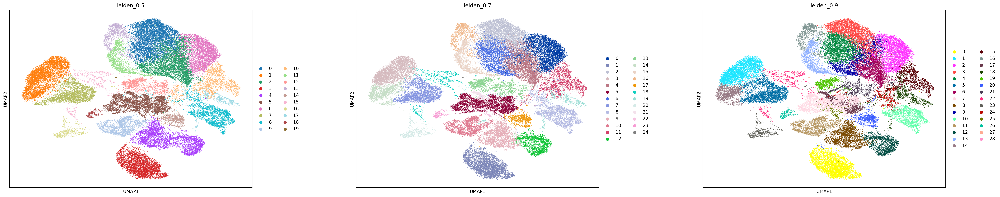

In [14]:
res_list = ["leiden_"+str(x) for x in cluster_res]
epi.pl.umap(adata ,color=res_list, size=3, ncols=3, wspace=0.3)

## Iterative Clustering Round 2

In [35]:
vardata = selectVarFeatures(adata, use_key="leiden_0.5")
vardata.X = vardata.layers["raw_counts"].copy()

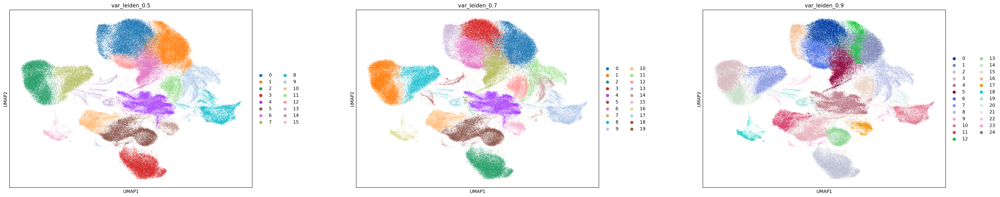

In [36]:
res_list = ["var_leiden_"+str(x) for x in cluster_res]
epi.pl.umap(vardata ,color=res_list, size=3, ncols=3, wspace=0.3)

## Iterative Clustering Round 3

In [47]:
adata.obs["var_leiden_0.5"] = vardata.obs["leiden_0.5"].copy()
vardata2 = selectVarFeatures(adata, use_key="var_leiden_0.5")
vardata2.X = vardata2.layers["raw_counts"].copy()

In [52]:
runTfIdf(vardata2)
runLsi(vardata2, cluster_key_added="var2_leiden")

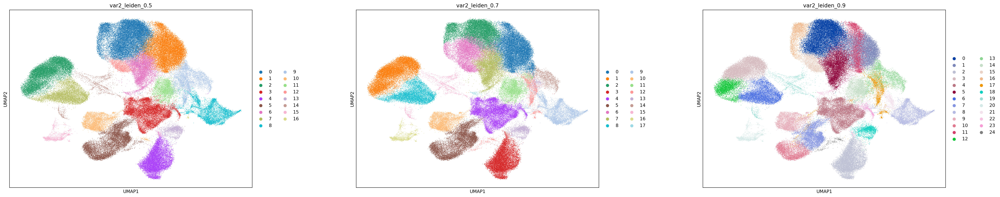

In [54]:
res_list = ["var2_leiden_"+str(x) for x in cluster_res]
epi.pl.umap(vardata2 ,color=res_list, size=3, ncols=3, wspace=0.3)

## Iterative Clustering Round 4

In [55]:
adata.obs["var2_leiden_0.5"] = vardata2.obs["var2_leiden_0.5"].copy()
vardata3 = selectVarFeatures(adata, use_key="var2_leiden_0.5")
vardata3.X = vardata3.layers["raw_counts"].copy()

In [56]:
runTfIdf(vardata3)
runLsi(vardata3, cluster_key_added="var3_leiden")

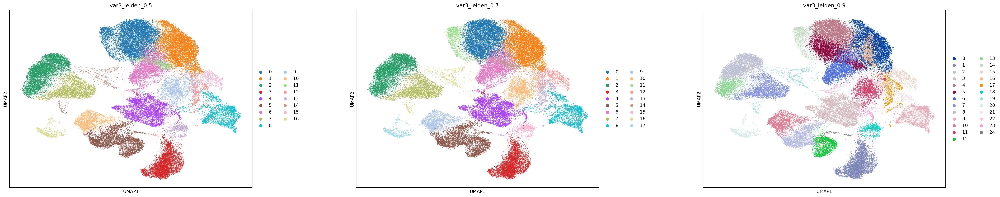

In [57]:
res_list = ["var3_leiden_"+str(x) for x in cluster_res]
epi.pl.umap(vardata3 ,color=res_list, size=3, ncols=3, wspace=0.3)

## Plot iterative clusters on original UMAP

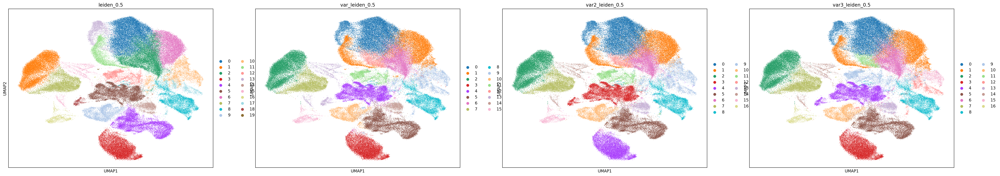

In [61]:
#adata.obs["var3_leiden_0.5"] = vardata3.obs["var3_leiden_0.5"].copy()
epi.pl.umap(adata, color=["leiden_0.5","var_leiden_0.5","var2_leiden_0.5","var3_leiden_0.5"], size=3)

## Plot iterative clusters on 3rd iter UMAP

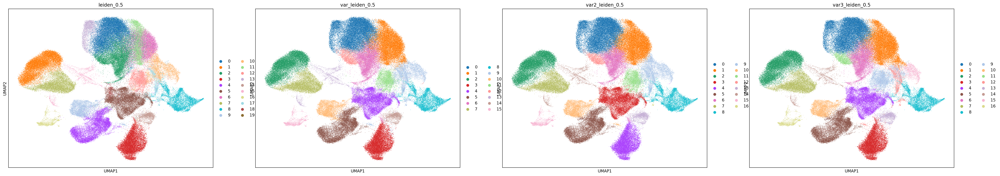

In [66]:
vardata2.obs["var3_leiden_0.5"] = vardata3.obs["var3_leiden_0.5"].copy()
epi.pl.umap(vardata2, color=["leiden_0.5","var_leiden_0.5","var2_leiden_0.5","var3_leiden_0.5"], size=3)

In [65]:
vardata2.obs["var3_leiden_0.5"] = vardata3.obs["var3_leiden_0.5"].copy()

### Plot cluster stats from Iteration 1

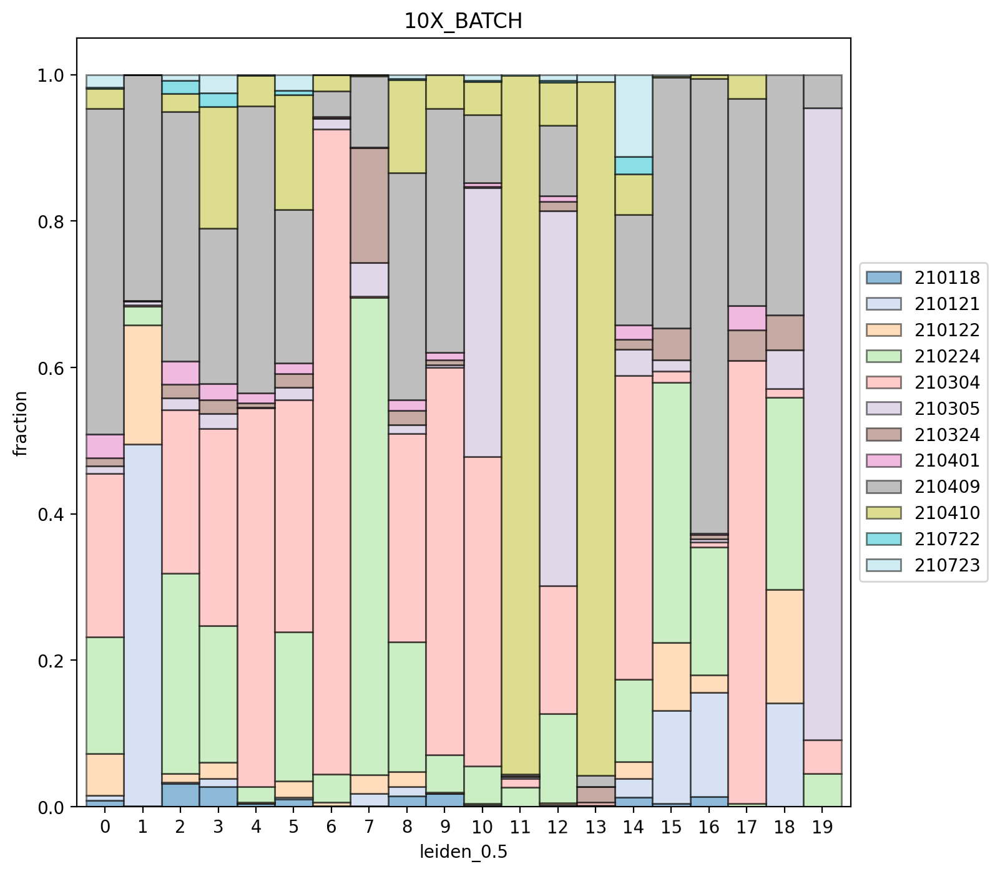

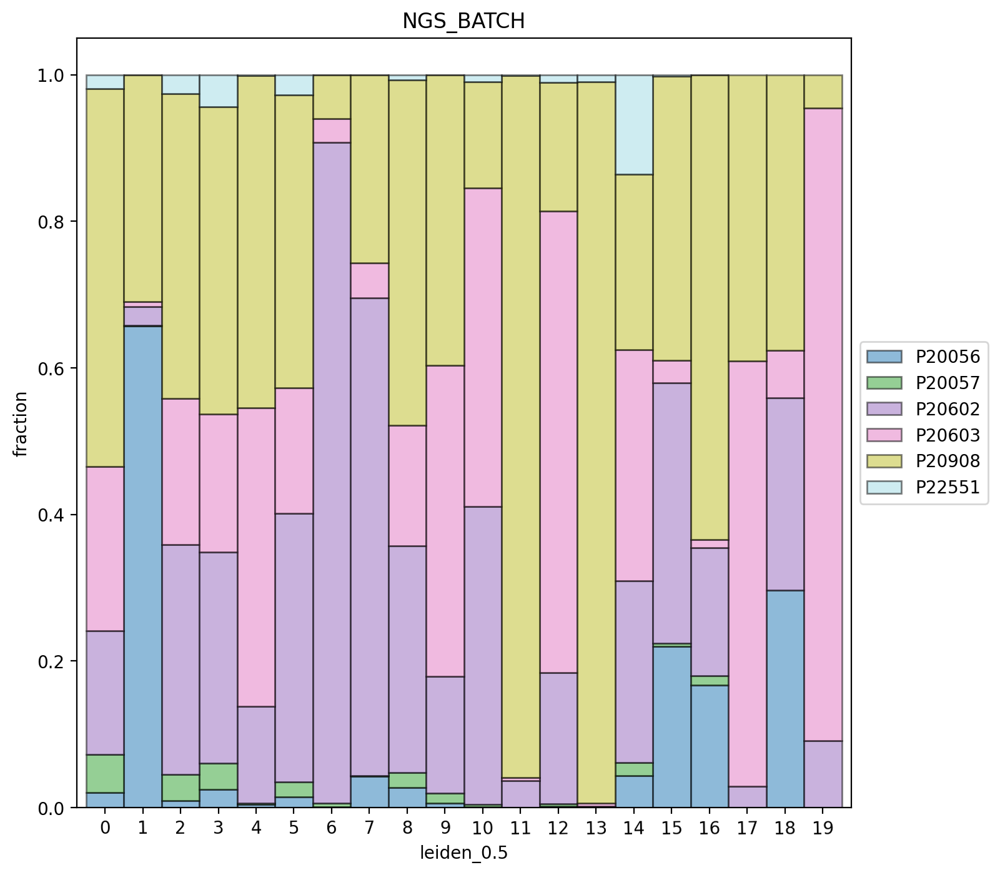

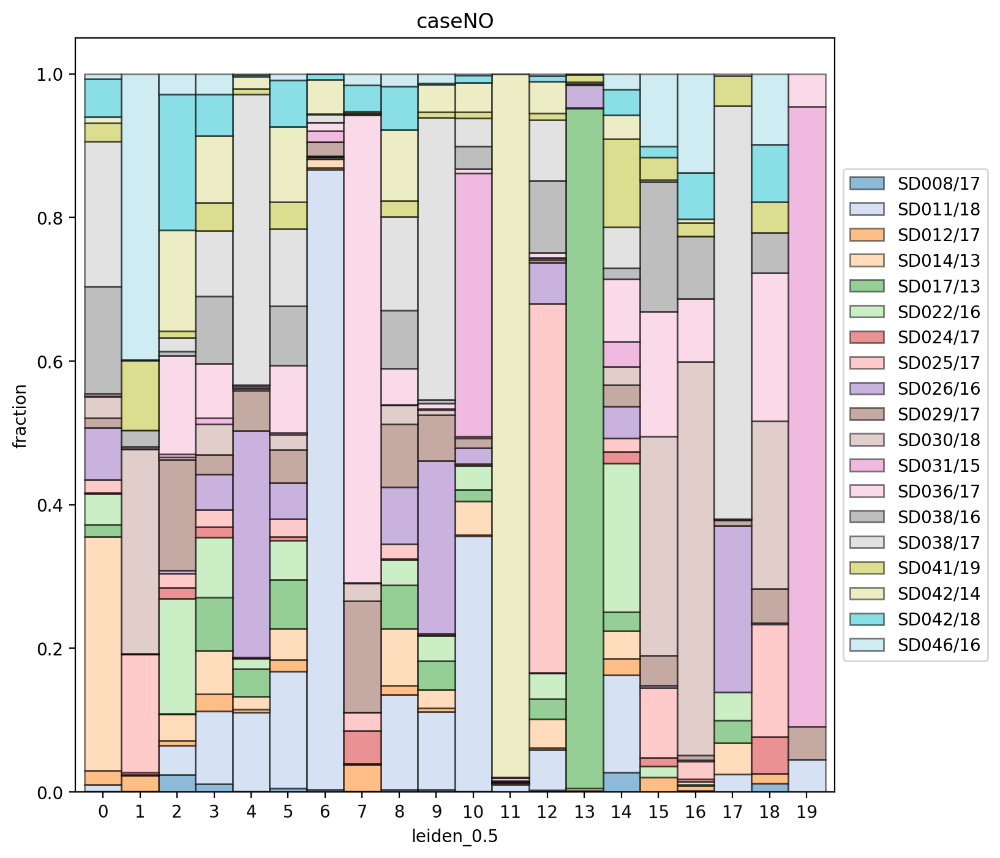

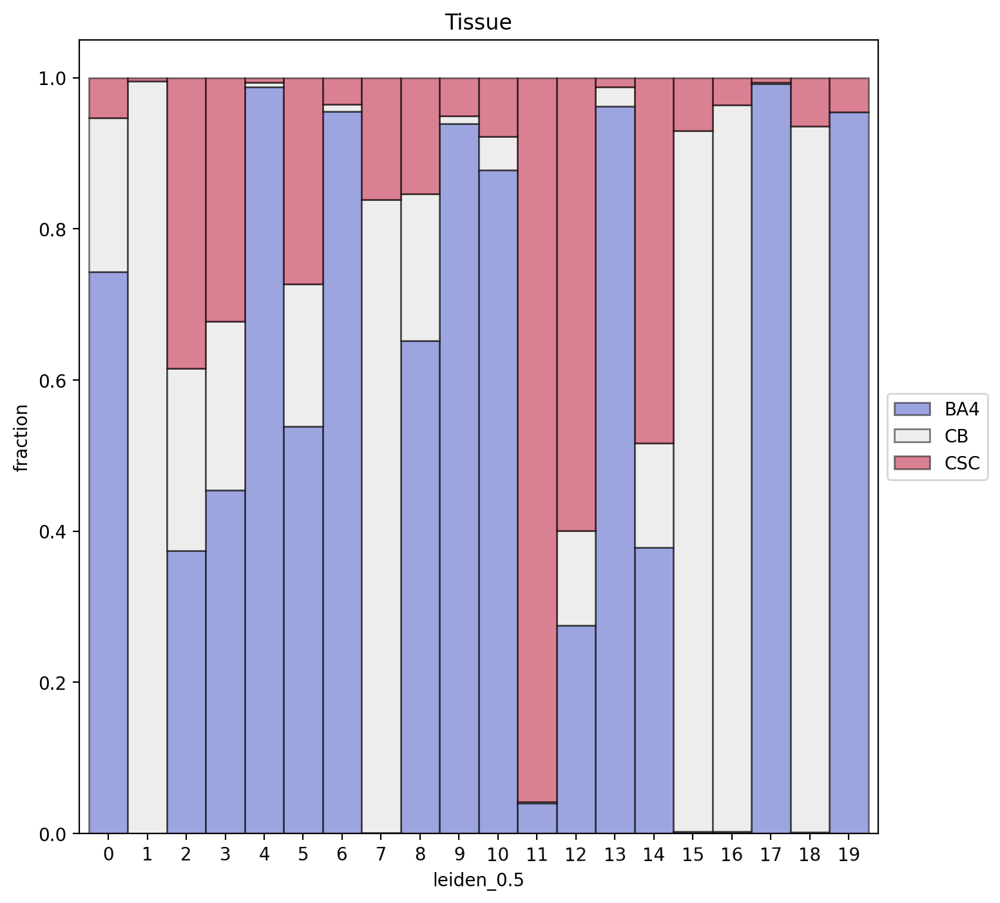

In [67]:
## stacked percentage bar plots 
for obs in ["10X_BATCH","NGS_BATCH","caseNO","Tissue"]:
    if obs=="Tissue":
        cmap = "coolwarm"
    else:
        cmap="tab20"
    grp_df = adata.obs.groupby(['leiden_0.5',obs])['nb_features'].count().unstack().T
    plt_df = grp_df.div(grp_df.sum())
    p1 = plt_df.T.plot(kind='bar', stacked=True, rot=1, figsize=(8,8),ylabel="fraction", edgecolor="black", width = 1, colormap=cmap, alpha=0.5, title=obs);
    p1.legend(loc='center left', bbox_to_anchor=(1, 0.5));

### Plot cluster stats from Iteration 3

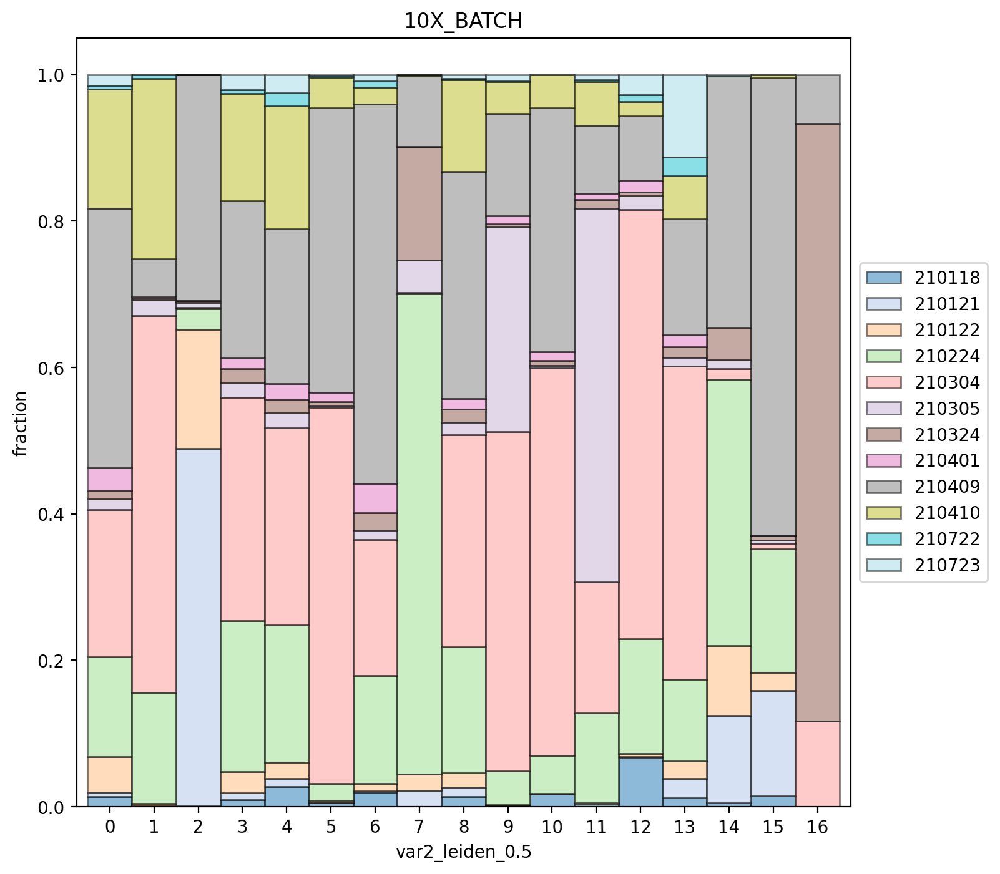

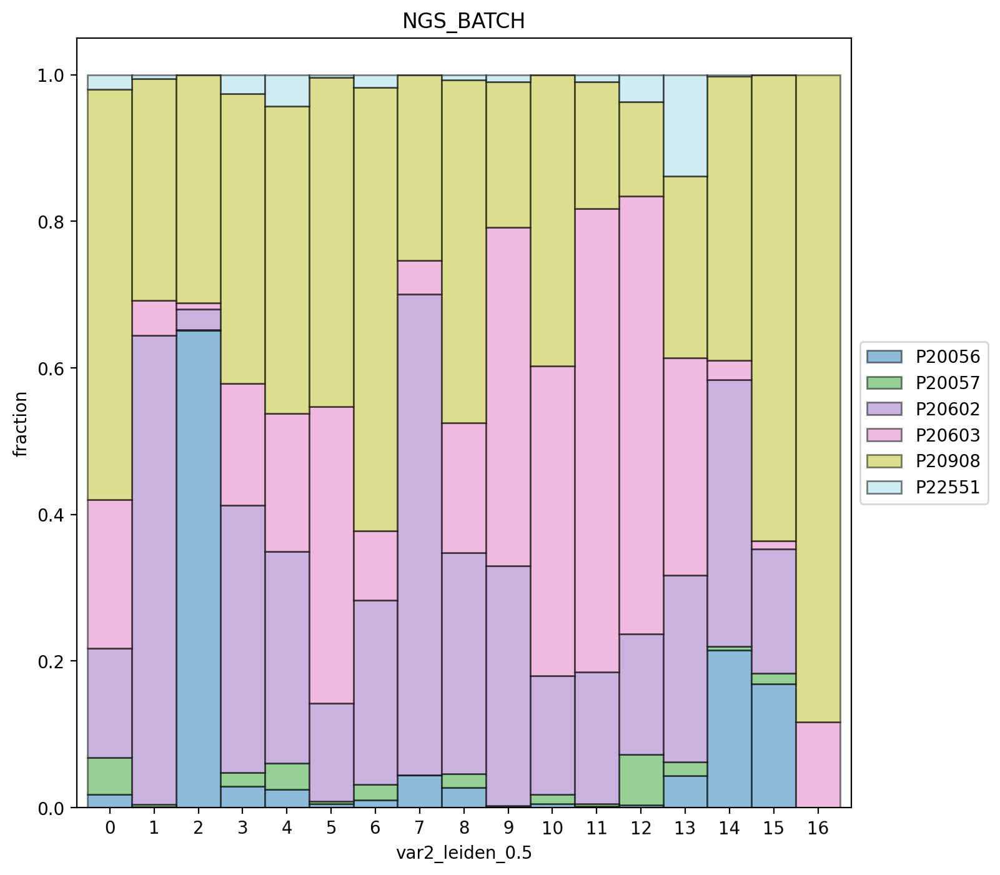

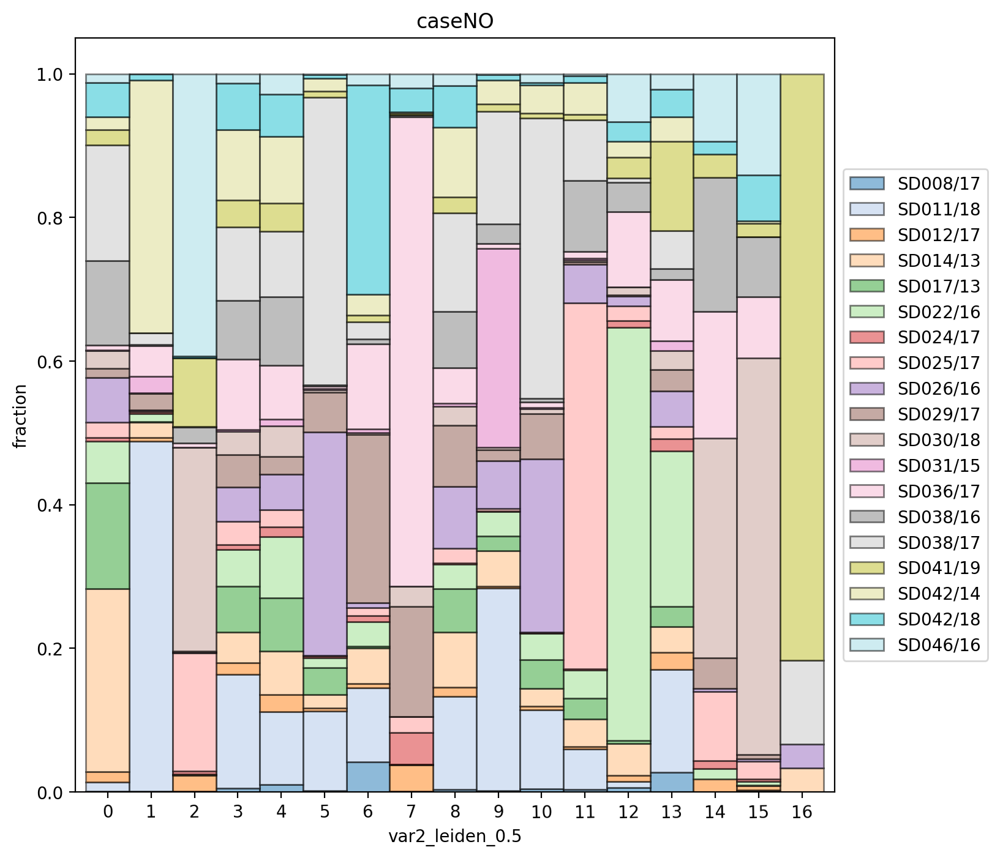

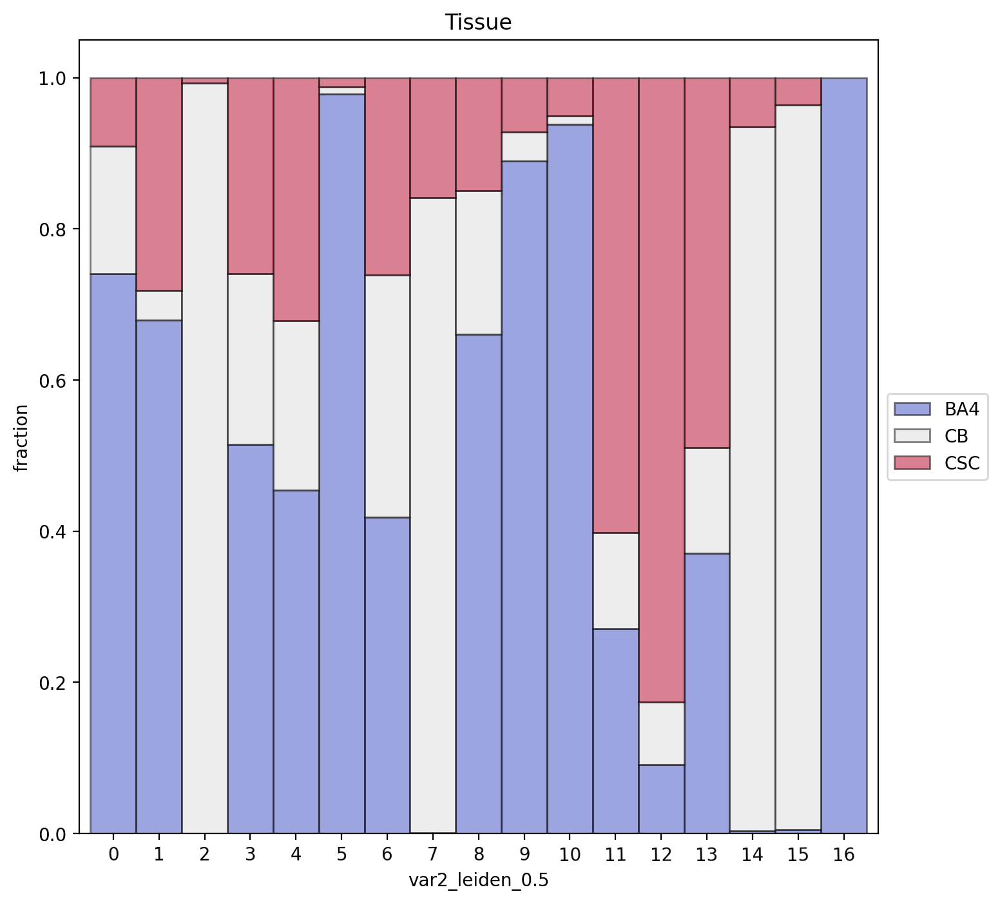

In [68]:
## stacked percentage bar plots 
for obs in ["10X_BATCH","NGS_BATCH","caseNO","Tissue"]:
    if obs=="Tissue":
        cmap = "coolwarm"
    else:
        cmap="tab20"
    grp_df = adata.obs.groupby(['var2_leiden_0.5',obs])['nb_features'].count().unstack().T
    plt_df = grp_df.div(grp_df.sum())
    p1 = plt_df.T.plot(kind='bar', stacked=True, rot=1, figsize=(8,8),ylabel="fraction", edgecolor="black", width = 1, colormap=cmap, alpha=0.5, title=obs);
    p1.legend(loc='center left', bbox_to_anchor=(1, 0.5));

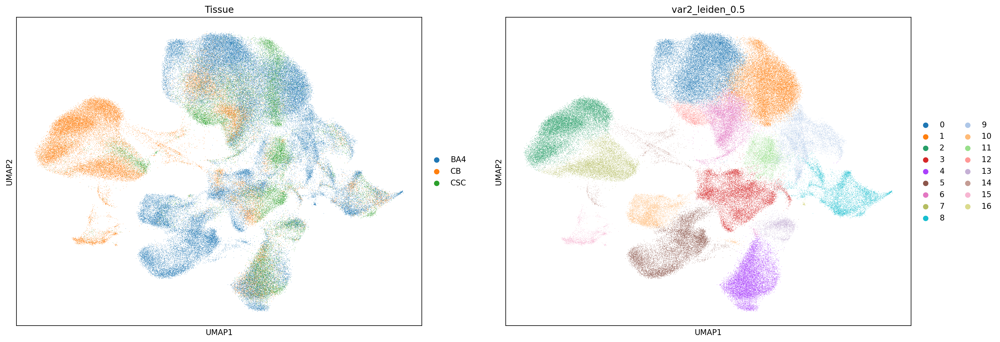

In [74]:
epi.pl.umap(vardata2, color=["Tissue","var2_leiden_0.5"])

### Save the Graph and UMAP coords from 3rd iteration in original adata object

In [76]:
adata.obsp["connectivities_iter3"] = vardata2.obsp["connectivities"].copy()
adata.obsp["distances_iter3"] = vardata2.obsp["distances"].copy()
adata.obsm["X_umap_iter3"] = vardata2.obsm["X_umap"].copy()

### Write results to file

In [78]:
adata.write("PIPELINE/data/matrices/211209_2kb_archrMatrix_LSI1_results.h5ad")

In [80]:
plt.rcParams["image.cmap"] = "inferno"

In [81]:
epi.tl.rank_features(adata, groupby="var2_leiden_0.5")

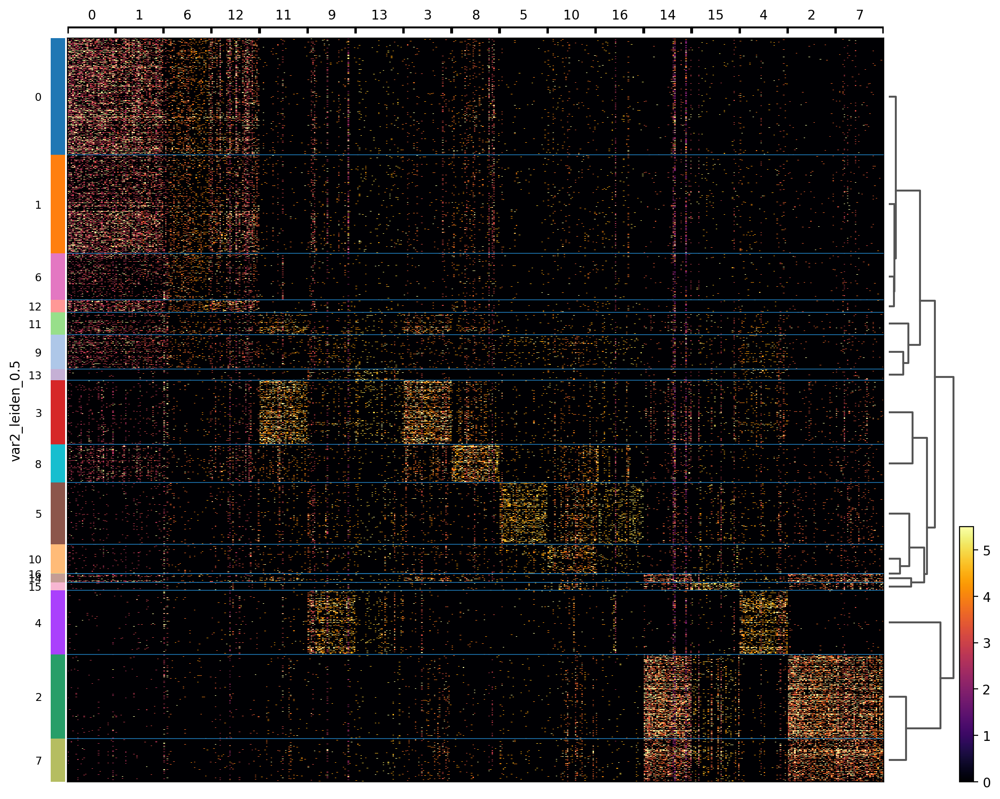

In [82]:
sc.pl.rank_genes_groups_heatmap(adata, key="rank_features_groups", figsize=(12.8,10.6), n_genes=30, vmax=5.5)